In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import warnings 
warnings.filterwarnings('ignore')

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

/kaggle/input/air-pollution-in-china-2015-2025/air_pollution_china.csv


In [2]:
df = pd.read_csv('/kaggle/input/air-pollution-in-china-2015-2025/air_pollution_china.csv')

In [3]:
df

,PM2.5 (µg/m³),PM10 (µg/m³),NO2 (µg/m³),SO2 (µg/m³),CO (mg/m³),O3 (µg/m³),Temperature (°C),Humidity (%),Wind Speed (m/s),Wind Direction (°),...,Season,City,Latitude,Longitude,Day of Week,Hour,Month,Year,Weather Condition,Station ID
0,94.437337,253.533160,57.759232,3.676372,2.568404,116.383653,4.578449,43.406082,7.861799,266.338889,...,Spring,Shenzhen,36.268122,112.199251,Sunday,2,7,2016,Haze,58
1,194.174790,165.605024,75.117403,22.243199,1.528823,178.428560,37.332250,27.446097,9.742233,27.266465,...,Spring,Shanghai,48.629080,105.238302,Monday,17,11,2017,Cloudy,18
2,45.037661,24.732526,61.400657,2.309529,2.629654,156.354832,30.325762,48.364322,1.749702,258.831639,...,Autumn,Beijing,32.155184,127.648336,Sunday,6,7,2017,Fog,35
3,76.131857,78.790750,77.274046,24.302389,1.732926,81.611939,7.405654,60.582658,8.791379,306.482163,...,Summer,Shanghai,45.400785,119.615793,Monday,17,3,2020,Snow,77
4,204.127929,62.680686,99.519372,48.842644,2.687827,70.314277,6.125376,79.890364,2.395132,154.210801,...,Spring,Beijing,40.353740,99.195910,Tuesday,3,12,2020,Clear,47
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2995,202.433868,213.848333,97.853248,20.543278,1.682403,128.810896,5.043363,86.091198,4.288590,124.457241,...,Autumn,Shanghai,22.436774,117.547069,Wednesday,17,6,2020,Haze,36
2996,216.182055,104.608468,92.595891,48.572856,0.527052,25.754024,33.054289,43.545969,3.208725,22.321887,...,Summer,Shenzhen,36.310211,114.532873,Sunday,12,11,2019,Haze,17
2997,155.490449,21.759054,7.158016,14.807278,3.043354,93.954234,11.862456,57.083113,5.814717,288.220855,...,Autumn,Shenzhen,29.709877,126.547063,Sunday,13,11,2015,Clear,1
2998,239.842895,195.061232,61.781015,15.070023,0.317404,193.777641,12.271151,98.610013,3.747732,331.660223,...,Autumn,Shanghai,40.062765,120.537238,Monday,12,9,2020,Fog,57


In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3000 entries, 0 to 2999
Data columns (total 24 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   PM2.5 (µg/m³)       3000 non-null   float64
 1   PM10 (µg/m³)        3000 non-null   float64
 2   NO2 (µg/m³)         3000 non-null   float64
 3   SO2 (µg/m³)         3000 non-null   float64
 4   CO (mg/m³)          3000 non-null   float64
 5   O3 (µg/m³)          3000 non-null   float64
 6   Temperature (°C)    3000 non-null   float64
 7   Humidity (%)        3000 non-null   float64
 8   Wind Speed (m/s)    3000 non-null   float64
 9   Wind Direction (°)  3000 non-null   float64
 10  Pressure (hPa)      3000 non-null   float64
 11  Precipitation (mm)  3000 non-null   float64
 12  Visibility (km)     3000 non-null   float64
 13  AQI                 3000 non-null   int64  
 14  Season              3000 non-null   object 
 15  City                3000 non-null   object 
 16  Latitu

In [5]:
df.describe()

,PM2.5 (µg/m³),PM10 (µg/m³),NO2 (µg/m³),SO2 (µg/m³),CO (mg/m³),O3 (µg/m³),Temperature (°C),Humidity (%),Wind Speed (m/s),Wind Direction (°),Pressure (hPa),Precipitation (mm),Visibility (km),AQI,Latitude,Longitude,Hour,Month,Year,Station ID
count,3000.000000,3000.000000,3000.000000,3000.000000,3000.000000,3000.000000,3000.000000,3000.000000,3000.000000,3000.000000,3000.000000,3000.000000,3000.000000,3000.000000,3000.000000,3000.000000,3000.000000,3000.000000,3000.000000,3000.000000
mean,130.072742,158.818398,52.948697,25.426127,2.562514,105.613365,15.117060,54.737773,5.137389,179.396411,1014.894063,24.880798,9.900773,249.639667,35.037328,110.072445,11.289667,6.537333,2019.555333,50.164667
std,68.140050,80.915207,26.905603,14.177923,1.409570,54.054354,14.719677,26.187670,2.891444,104.076767,20.348410,14.638862,5.751453,143.396118,8.666335,11.604091,6.835057,3.441204,2.850669,28.807838
min,10.039019,20.017134,5.005047,1.014693,0.102207,10.094551,-9.997818,10.049686,0.002052,0.017217,980.020253,0.002508,0.103173,0.000000,20.005034,90.006533,0.000000,1.000000,2015.000000,1.000000
25%,72.409621,86.982912,29.885955,12.720078,1.362659,59.561719,2.123508,31.915813,2.601402,87.632382,997.419156,12.036467,4.997298,126.000000,27.495695,100.001894,5.750000,4.000000,2017.000000,26.000000
50%,128.858172,157.174723,53.404879,25.677423,2.553778,106.706302,15.334326,53.993836,5.206242,178.820576,1014.296950,24.785057,9.850522,248.000000,35.148201,110.181877,11.000000,7.000000,2020.000000,49.000000
75%,188.579931,228.603910,75.955623,37.755735,3.785613,151.293020,28.016646,77.409183,7.750817,268.835379,1032.671602,37.617215,14.808608,374.000000,42.612931,119.977826,17.000000,10.000000,2022.000000,75.000000
max,249.847473,299.702293,99.979511,49.989850,4.998658,199.936387,39.959957,99.998108,9.991277,359.881532,1049.997553,49.984126,19.998597,499.000000,49.998873,129.989284,23.000000,12.000000,2024.000000,99.000000


In [6]:
import matplotlib.pyplot as plt
import seaborn as sns

In [7]:
df.columns

Index(['PM2.5 (µg/m³)', 'PM10 (µg/m³)', 'NO2 (µg/m³)', 'SO2 (µg/m³)',
       'CO (mg/m³)', 'O3 (µg/m³)', 'Temperature (°C)', 'Humidity (%)',
       'Wind Speed (m/s)', 'Wind Direction (°)', 'Pressure (hPa)',
       'Precipitation (mm)', 'Visibility (km)', 'AQI', 'Season', 'City',
       'Latitude', 'Longitude', 'Day of Week', 'Hour', 'Month', 'Year',
       'Weather Condition', 'Station ID'],
      dtype='object')

In [8]:
cols = [ 'Season', 'City', 'Day of Week', 'Hour', 'Month', 'Year',
       'Weather Condition', 'Station ID']

# DATA VIZUALTIZATION

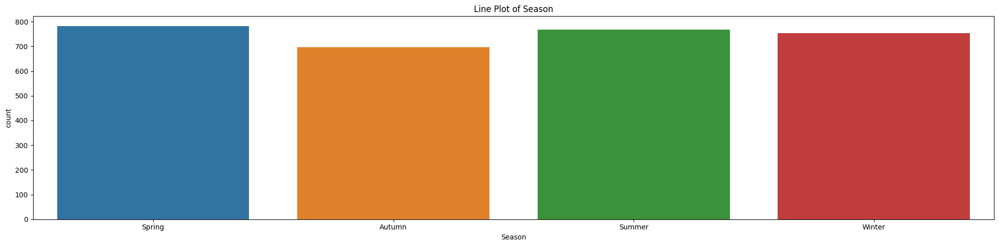

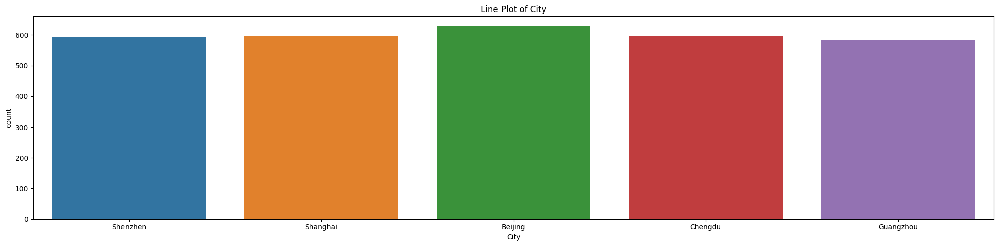

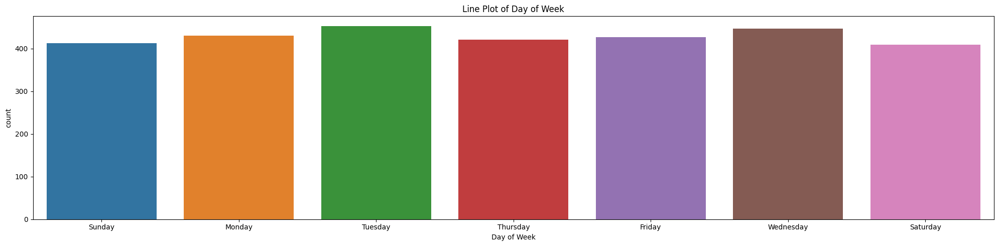

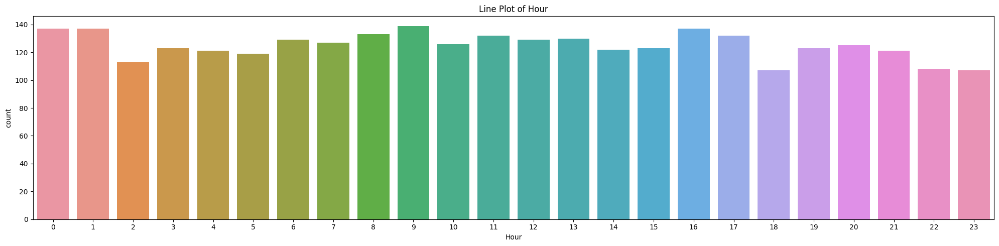

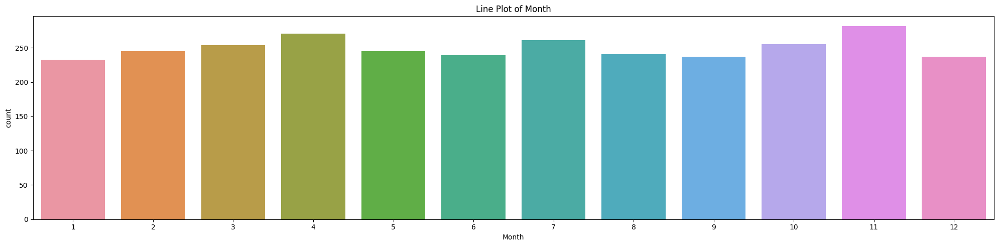

...

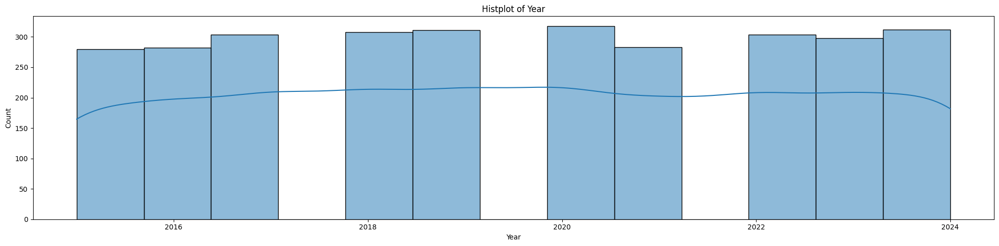

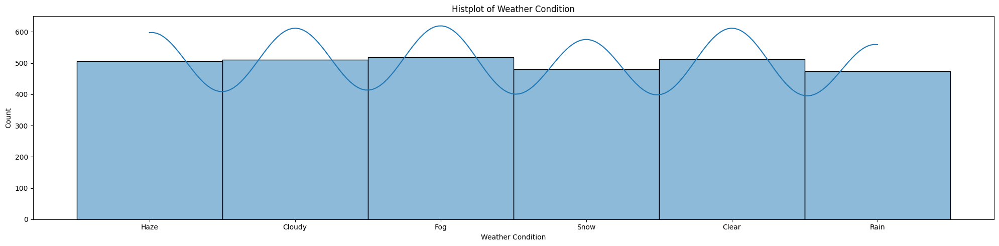

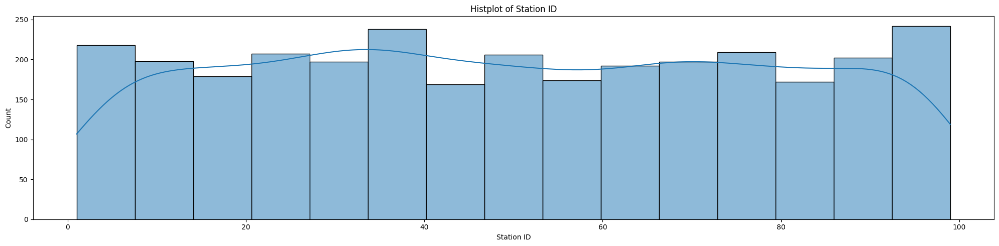

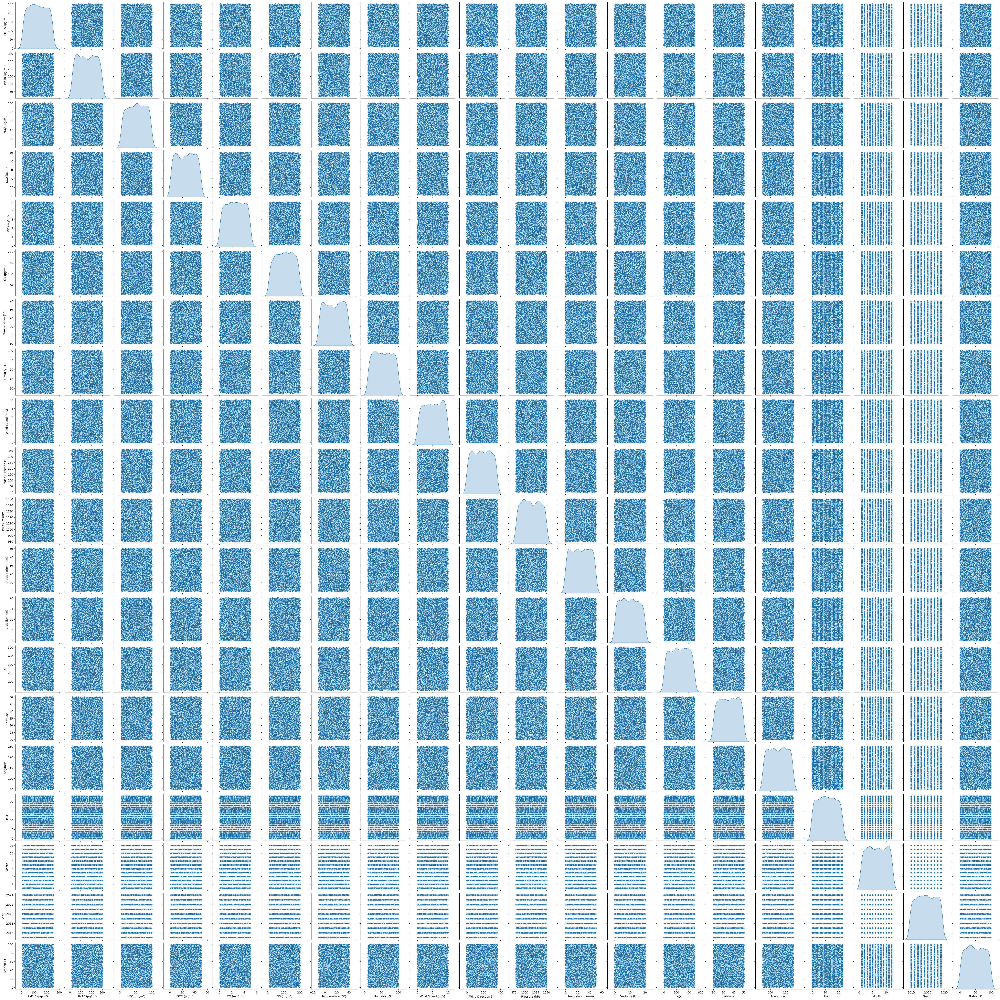

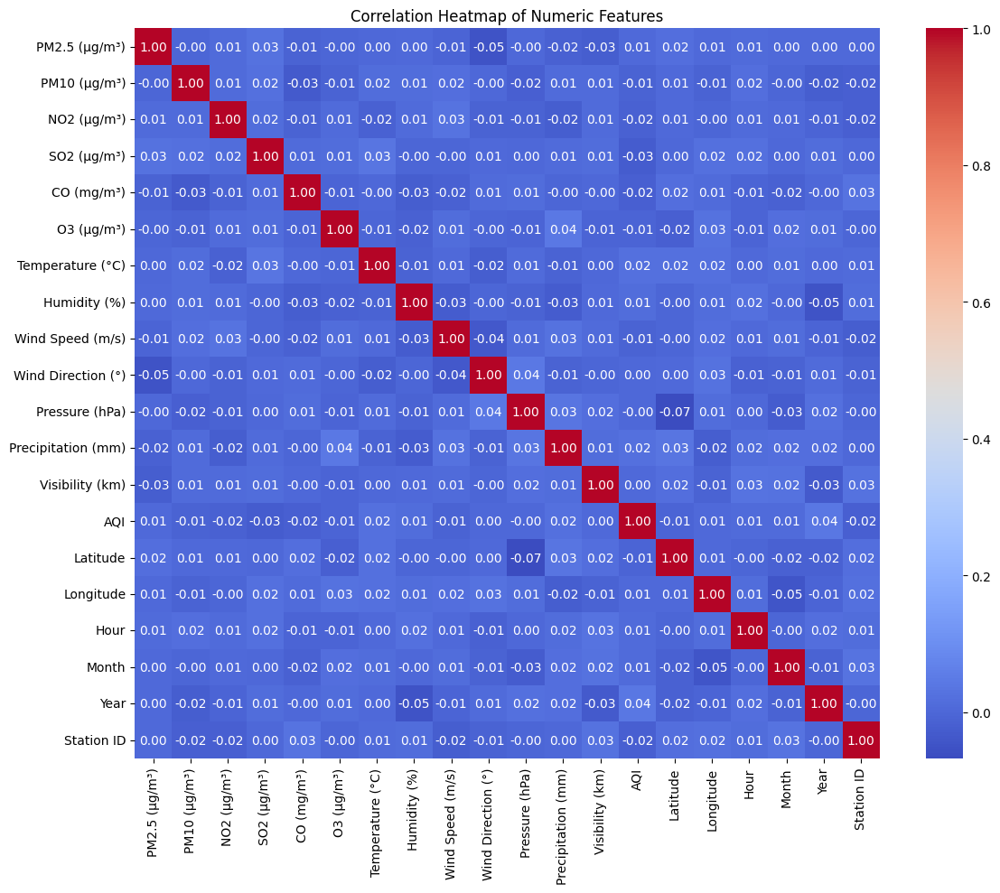

In [9]:
# COUNT PLOT

for features in cols:
    if features in df.columns:
        plt.figure(figsize=(20,5))
        sns.countplot(x=features,data=df)
        plt.title(f'Line Plot of {features}')
        plt.tight_layout()
        plt.show()


#HISTOGRAM PLOT

for features in cols:
    if features in df.columns:
        plt.figure(figsize=(20,5))
        sns.histplot(df[features].dropna(),kde=True)
        plt.title(f'Histplot of {features}')
        plt.tight_layout()
        plt.show()

feat = ['PM2.5 (µg/m³)', 'PM10 (µg/m³)', 'NO2 (µg/m³)', 'SO2 (µg/m³)',
       'CO (mg/m³)', 'O3 (µg/m³)', 'Temperature (°C)', 'Humidity (%)',
       'Wind Speed (m/s)', 'Wind Direction (°)', 'Pressure (hPa)',
       'Precipitation (mm)', 'Visibility (km)', 'AQI', 'Season', 'City',
       'Latitude', 'Longitude', 'Day of Week', 'Hour', 'Month', 'Year',
       'Weather Condition', 'Station ID']


# PAIR PLOT

if set(feat).issubset(df.columns):
    sns.pairplot(df[feat].dropna(),diag_kind='kde')
    plt.show()



# HEAT MAP

numeric_df = df.select_dtypes(include=[np.number])
if numeric_df.shape[1] >= 4:
    plt.figure(figsize=(12,10))
    correlation_matrix = numeric_df.corr()
    sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt='.2f')
    plt.title('Correlation Heatmap of Numeric Features')
    plt.tight_layout()
    plt.show()

In [10]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3000 entries, 0 to 2999
Data columns (total 24 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   PM2.5 (µg/m³)       3000 non-null   float64
 1   PM10 (µg/m³)        3000 non-null   float64
 2   NO2 (µg/m³)         3000 non-null   float64
 3   SO2 (µg/m³)         3000 non-null   float64
 4   CO (mg/m³)          3000 non-null   float64
 5   O3 (µg/m³)          3000 non-null   float64
 6   Temperature (°C)    3000 non-null   float64
 7   Humidity (%)        3000 non-null   float64
 8   Wind Speed (m/s)    3000 non-null   float64
 9   Wind Direction (°)  3000 non-null   float64
 10  Pressure (hPa)      3000 non-null   float64
 11  Precipitation (mm)  3000 non-null   float64
 12  Visibility (km)     3000 non-null   float64
 13  AQI                 3000 non-null   int64  
 14  Season              3000 non-null   object 
 15  City                3000 non-null   object 
 16  Latitu

In [11]:
lab = ['Season','City','Day of Week','Weather Condition']

# DATA PREPROCESSING

In [12]:
from sklearn.model_selection import RandomizedSearchCV, GridSearchCV, train_test_split
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import accuracy_score,r2_score,mean_squared_error,mean_absolute_error

In [13]:
le = LabelEncoder()

In [14]:
for column in lab:
    df[column] = le.fit_transform(df[column])

In [15]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3000 entries, 0 to 2999
Data columns (total 24 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   PM2.5 (µg/m³)       3000 non-null   float64
 1   PM10 (µg/m³)        3000 non-null   float64
 2   NO2 (µg/m³)         3000 non-null   float64
 3   SO2 (µg/m³)         3000 non-null   float64
 4   CO (mg/m³)          3000 non-null   float64
 5   O3 (µg/m³)          3000 non-null   float64
 6   Temperature (°C)    3000 non-null   float64
 7   Humidity (%)        3000 non-null   float64
 8   Wind Speed (m/s)    3000 non-null   float64
 9   Wind Direction (°)  3000 non-null   float64
 10  Pressure (hPa)      3000 non-null   float64
 11  Precipitation (mm)  3000 non-null   float64
 12  Visibility (km)     3000 non-null   float64
 13  AQI                 3000 non-null   int64  
 14  Season              3000 non-null   int64  
 15  City                3000 non-null   int64  
 16  Latitu

In [16]:
df

,PM2.5 (µg/m³),PM10 (µg/m³),NO2 (µg/m³),SO2 (µg/m³),CO (mg/m³),O3 (µg/m³),Temperature (°C),Humidity (%),Wind Speed (m/s),Wind Direction (°),...,Season,City,Latitude,Longitude,Day of Week,Hour,Month,Year,Weather Condition,Station ID
0,94.437337,253.533160,57.759232,3.676372,2.568404,116.383653,4.578449,43.406082,7.861799,266.338889,...,1,4,36.268122,112.199251,3,2,7,2016,3,58
1,194.174790,165.605024,75.117403,22.243199,1.528823,178.428560,37.332250,27.446097,9.742233,27.266465,...,1,3,48.629080,105.238302,1,17,11,2017,1,18
2,45.037661,24.732526,61.400657,2.309529,2.629654,156.354832,30.325762,48.364322,1.749702,258.831639,...,0,0,32.155184,127.648336,3,6,7,2017,2,35
3,76.131857,78.790750,77.274046,24.302389,1.732926,81.611939,7.405654,60.582658,8.791379,306.482163,...,2,3,45.400785,119.615793,1,17,3,2020,5,77
4,204.127929,62.680686,99.519372,48.842644,2.687827,70.314277,6.125376,79.890364,2.395132,154.210801,...,1,0,40.353740,99.195910,5,3,12,2020,0,47
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2995,202.433868,213.848333,97.853248,20.543278,1.682403,128.810896,5.043363,86.091198,4.288590,124.457241,...,0,3,22.436774,117.547069,6,17,6,2020,3,36
2996,216.182055,104.608468,92.595891,48.572856,0.527052,25.754024,33.054289,43.545969,3.208725,22.321887,...,2,4,36.310211,114.532873,3,12,11,2019,3,17
2997,155.490449,21.759054,7.158016,14.807278,3.043354,93.954234,11.862456,57.083113,5.814717,288.220855,...,0,4,29.709877,126.547063,3,13,11,2015,0,1
2998,239.842895,195.061232,61.781015,15.070023,0.317404,193.777641,12.271151,98.610013,3.747732,331.660223,...,0,3,40.062765,120.537238,1,12,9,2020,2,57


In [17]:
df.columns

Index(['PM2.5 (µg/m³)', 'PM10 (µg/m³)', 'NO2 (µg/m³)', 'SO2 (µg/m³)',
       'CO (mg/m³)', 'O3 (µg/m³)', 'Temperature (°C)', 'Humidity (%)',
       'Wind Speed (m/s)', 'Wind Direction (°)', 'Pressure (hPa)',
       'Precipitation (mm)', 'Visibility (km)', 'AQI', 'Season', 'City',
       'Latitude', 'Longitude', 'Day of Week', 'Hour', 'Month', 'Year',
       'Weather Condition', 'Station ID'],
      dtype='object')

In [18]:
df = df.drop(columns=['Temperature (°C)', 'Pressure (hPa)',
       'Precipitation (mm)', 'Season', 'City', 'Longitude', 'Day of Week', 'Hour', 'Month', 'Year',
       'Weather Condition', 'Station ID'])

In [19]:
rem = ['PM2.5 (µg/m³)', 'PM10 (µg/m³)', 'NO2 (µg/m³)', 'SO2 (µg/m³)',
       'CO (mg/m³)', 'O3 (µg/m³)', 'Humidity (%)', 'Pressure (hPa)',
       'Precipitation (mm)', 'AQI', 
        'Longitude']

In [20]:
df.astype(int)

,PM2.5 (µg/m³),PM10 (µg/m³),NO2 (µg/m³),SO2 (µg/m³),CO (mg/m³),O3 (µg/m³),Humidity (%),Wind Speed (m/s),Wind Direction (°),Visibility (km),AQI,Latitude
0,94,253,57,3,2,116,43,7,266,18,4,36
1,194,165,75,22,1,178,27,9,27,2,48,48
2,45,24,61,2,2,156,48,1,258,0,49,32
3,76,78,77,24,1,81,60,8,306,14,271,45
4,204,62,99,48,2,70,79,2,154,10,372,40
...,...,...,...,...,...,...,...,...,...,...,...,...
2995,202,213,97,20,1,128,86,4,124,18,199,22
2996,216,104,92,48,0,25,43,3,22,14,83,36
2997,155,21,7,14,3,93,57,5,288,19,284,29
2998,239,195,61,15,0,193,98,3,331,5,101,40


# MODEL SECTION

In [21]:
X = df.drop(columns=['AQI'])
y = df['AQI']

In [22]:
X_train,X_test,y_train,y_test = train_test_split(X,y,test_size=0.2,random_state=42)

In [23]:
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeRegressor


In [24]:
lr = DecisionTreeRegressor()

In [25]:
lr.fit(X_train,y_train)

DecisionTreeRegressor()

In [26]:
y_pred_lr = lr.predict(X_test)

In [27]:
r2 = r2_score(y_pred_lr,y_test)
print(f'r2:', r2)

r2: -0.9515437064129335


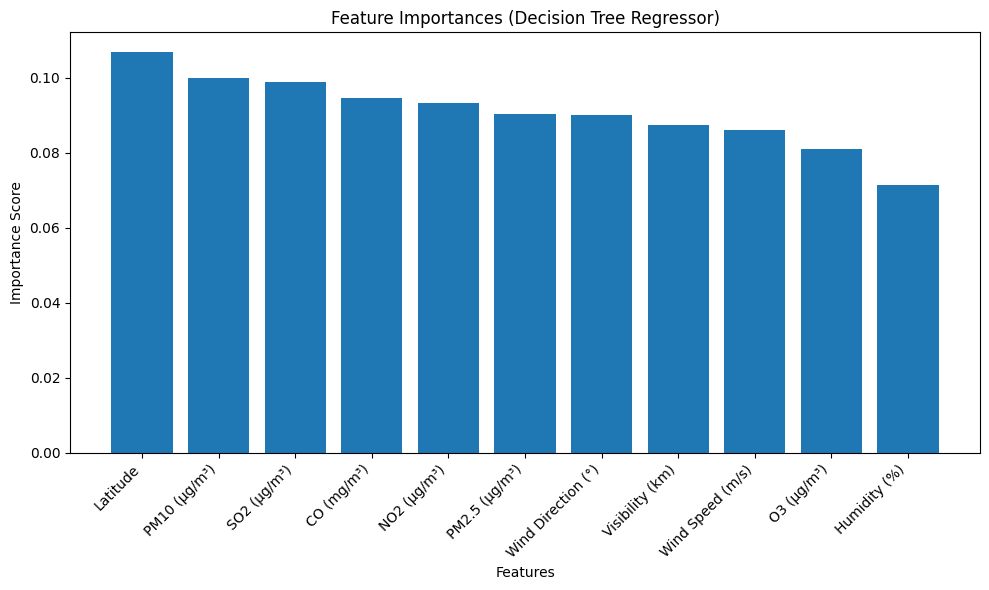

In [28]:
# Get feature importances
importances = lr.feature_importances_
features = X.columns

# Create a bar plot
plt.figure(figsize=(10, 6))
sorted_idx = importances.argsort()[::-1]
plt.bar(range(len(importances)), importances[sorted_idx], align='center')
plt.xticks(range(len(importances)), features[sorted_idx], rotation=45, ha='right')
plt.title("Feature Importances (Decision Tree Regressor)")
plt.xlabel("Features")
plt.ylabel("Importance Score")
plt.tight_layout()
plt.show()

In [29]:
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor,RandomForestClassifier

In [30]:
rf = GradientBoostingRegressor(n_estimators=500,learning_rate=0.001,max_depth=5,min_samples_split=5,
                               min_samples_leaf=2,subsample=0.8,max_features='sqrt',loss='huber',random_state=42)

In [31]:
rf.fit(X_train,y_train)

GradientBoostingRegressor(learning_rate=0.001, loss='huber', max_depth=5,
                          max_features='sqrt', min_samples_leaf=2,
                          min_samples_split=5, n_estimators=500,
                          random_state=42, subsample=0.8)

In [32]:
y_pred_rf = rf.predict(X_test)

In [33]:
mae = mean_absolute_error(y_test, y_pred_rf)
mse = mean_squared_error(y_test, y_pred_rf,squared=False)
r2 = r2_score(y_test, y_pred_rf)

print(f"MAE :", mae)
print("MSE :", mse)
print("R² Score :", r2*100)

MAE : 122.57669196063608
MSE : 141.99716438934794
R² Score : -0.6588634553291284


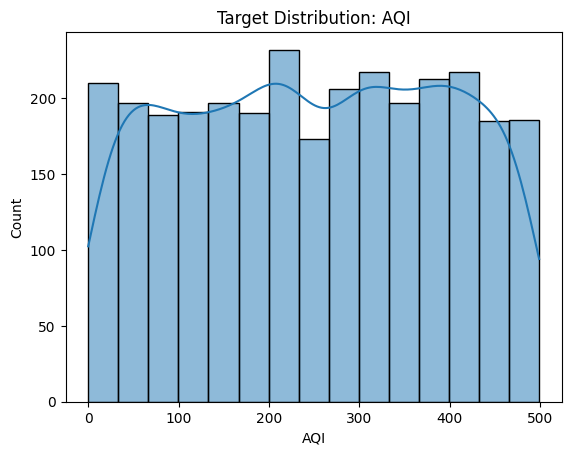

In [34]:
import seaborn as sns
import matplotlib.pyplot as plt

sns.histplot(y, kde=True)
plt.title("Target Distribution: AQI")
plt.show()


In [35]:
from xgboost import XGBRegressor
xgb = XGBRegressor(n_estimators=500, learning_rate=0.1, max_depth=6)


In [36]:
xgb.fit(X_train,y_train)

XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=None, device=None, early_stopping_rounds=None,
             enable_categorical=False, eval_metric=None, feature_types=None,
             gamma=None, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=0.1, max_bin=None,
             max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=6, max_leaves=None,
             min_child_weight=None, missing=nan, monotone_constraints=None,
             multi_strategy=None, n_estimators=500, n_jobs=None,
             num_parallel_tree=None, random_state=None, ...)

In [37]:
y_pred_xg = xgb.predict(X_test)

# Metrics
mae = mean_absolute_error(y_test, y_pred_xg)
mse = mean_squared_error(y_test, y_pred_xg)
r2 = r2_score(y_test, y_pred_xg)

print(f"MAE: {mae:.2f}")
print(f"MSE: {mse:.2f}")
print(f"R² Score: {r2:.2f}")

MAE: 133.15
MSE: 24689.97
R² Score: -0.23


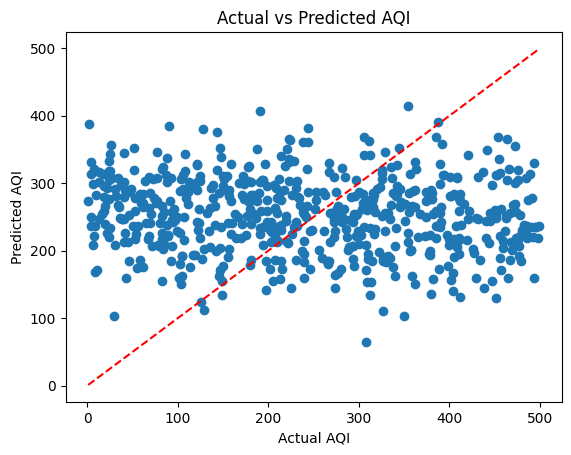

In [38]:
import matplotlib.pyplot as plt

plt.scatter(y_test, y_pred_xg)
plt.xlabel("Actual AQI")
plt.ylabel("Predicted AQI")
plt.title("Actual vs Predicted AQI")
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'r--')
plt.show()


In [39]:
from lightgbm import LGBMRegressor
lgbm = LGBMRegressor(n_estimators=500, learning_rate=0.1, max_depth=6)


In [40]:
lgbm.fit(X_train,y_train)

y_pred_lg = xgb.predict(X_test)

# Metrics
mae = mean_absolute_error(y_test, y_pred_lg)
mse = mean_squared_error(y_test, y_pred_lg)
r2 = r2_score(y_test, y_pred_lg)

print(f"MAE: {mae:.2f}")
print(f"MSE: {mse:.2f}")
print(f"R² Score: {r2:.2f}")

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003137 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2805
[LightGBM] [Info] Number of data points in the train set: 2400, number of used features: 11
[LightGBM] [Info] Start training from score 250.899167
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive

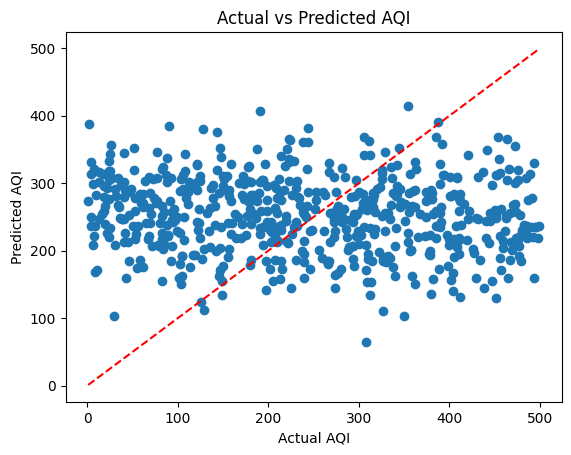

In [41]:
import matplotlib.pyplot as plt

plt.scatter(y_test, y_pred_lg)
plt.xlabel("Actual AQI")
plt.ylabel("Predicted AQI")
plt.title("Actual vs Predicted AQI")
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'r--')
plt.show()


# CONCLUSION:
> NEED FEATURE ENGINEERING FOR MORE OPTIMAL OUTPUT